# Model Training Testing and Evaluation 

## Models:
We will be utilizing the following models: 
* Neural Network 
* Ensemble 
* Logistic Regressor / SVM 
* Linear Regressor 

This notebook contains the code relating to training models and evaluating them 

In [1]:
import pandas as pd 
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.manifold import TSNE
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn import metrics
from statistics import mode
from sklearn.metrics import roc_auc_score
from sklearn.neural_network import MLPRegressor

In [2]:
df = pd.read_csv('merged70k.csv').set_index('tconst')
df.dropna(inplace=True) 
df

,averageRating,numVotes,isAdult,startYear,runtimeMinutes,actor_nm0555550,actor_nm0245596,actor_nm0068501,actor_nm0001825,actor_nm0138287,...,writers_nm5238285,writers_nm3298048,writers_nm1018426,writers_nm1889381,writers_nm9555338,writers_nm1493942,writers_nm0470741,writers_nm2562555,writers_nm2010047,writers_non_100_category
tconst,,,,,,,,,,,,,,,,,,,,,
tt2126403,7.2,2623.0,0,2013.0,97.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0252695,7.8,8943.0,0,1975.0,79.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt2425486,6.9,8839.0,0,2013.0,110.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0246266,6.9,2690.0,0,2000.0,88.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt5029208,6.3,754.0,0,2017.0,126.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tt0427873,6.7,355.0,0,2005.0,95.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt6494358,7.5,958.0,0,2017.0,123.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0297753,6.0,4016.0,0,2003.0,85.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [3]:
genres = [entry for entry in df.keys() if 'genre' in entry]

for genre in genres:
    rows = df.loc[df[genre] == 1]
    
    print("Distribution for genre ", genre)
    fig = px.histogram(rows, x='averageRating', y='numVotes', marginal='box')
    fig.show() 
    

Distribution for genre  genres_Short


Distribution for genre  genres_Talk-Show


Distribution for genre  genres_Reality-TV


Distribution for genre  genres_\N


Distribution for genre  genres_News


Distribution for genre  genres_Adult


Distribution for genre  genres_Film-Noir


Distribution for genre  genres_Western


Distribution for genre  genres_Sport


Distribution for genre  genres_Musical


Distribution for genre  genres_War


Distribution for genre  genres_Animation


Distribution for genre  genres_Music


Distribution for genre  genres_History


Distribution for genre  genres_Biography


Distribution for genre  genres_Family


Distribution for genre  genres_Sci-Fi


Distribution for genre  genres_Fantasy


Distribution for genre  genres_Documentary


Distribution for genre  genres_Mystery


Distribution for genre  genres_Adventure


Distribution for genre  genres_Horror


Distribution for genre  genres_Crime


Distribution for genre  genres_Thriller


Distribution for genre  genres_Action


Distribution for genre  genres_Romance


Distribution for genre  genres_Comedy


Distribution for genre  genres_Drama


Distribution for genre  genres_non_100_category


In [4]:
fig = px.histogram(df, x='averageRating', y='numVotes', marginal='box')
fig.show() 

fig = px.histogram(df, x='averageRating', y='averageRating', marginal='box')
fig.show() 

In [4]:
# Normalization of the Dataframe 

scaler = StandardScaler().fit(df) 

x_scaled = scaler.transform(df)

keys = list(df.keys())

for idx in range(len(x_scaled[0])):
    col = x_scaled[:,idx]
    
    df[keys[idx]] = col 

df

,averageRating,numVotes,isAdult,startYear,runtimeMinutes,actor_nm0555550,actor_nm0245596,actor_nm0068501,actor_nm0001825,actor_nm0138287,...,writers_nm5238285,writers_nm3298048,writers_nm1018426,writers_nm1889381,writers_nm9555338,writers_nm1493942,writers_nm0470741,writers_nm2562555,writers_nm2010047,writers_non_100_category
tconst,,,,,,,,,,,,,,,,,,,,,
tt2126403,0.891797,-0.166155,-0.038025,0.689785,-0.158561,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt0252695,1.372284,-0.070504,-0.038025,-0.934978,-0.743305,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt2425486,0.651553,-0.072078,-0.038025,0.689785,0.263754,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt0246266,0.651553,-0.165141,-0.038025,0.133945,-0.450933,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt5029208,0.171065,-0.194442,-0.038025,0.860813,0.783527,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tt0427873,0.491390,-0.200480,-0.038025,0.347730,-0.223533,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt6494358,1.132040,-0.191354,-0.038025,0.860813,0.686069,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0
tt0297753,-0.069178,-0.145073,-0.038025,0.262216,-0.548390,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,...,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,-0.003781,0.0


In [5]:
# We want slices so im disabling the warning about it 
pd.options.mode.chained_assignment = None
def run_model(model, SPLITS=5):
    """
        Runs a given model and reports the provided metrics on our sets
        
        Utilizes K-Fold CV and reports Regression Metrics 
        
        Returns the list of classifiers 
    """
    # Idx 0 is training, idx 1 is testing 
    mse_totals = [0,0]
    r2_totals = [0,0]
    
    kf = KFold(n_splits=SPLITS, random_state=12, shuffle=True)
        
    for train_index, test_index in kf.split(df.index):
        x_train = df.iloc[list(train_index)]
        x_test = df.iloc[list(test_index)]
        
        y_train = list(x_train['averageRating'])
        y_test = list(x_test['averageRating']) 
        
        x_train.drop(columns=['averageRating','numVotes'], inplace=True) 
        x_test.drop(columns=['averageRating','numVotes'], inplace=True)    
   
        clf = model.fit(x_train, y_train) 
        
        train_preds = clf.predict(x_train)
        mse_train = mean_squared_error(y_train, train_preds)
        r2_train = r2_score(y_train, train_preds)
        
        mse_totals[0] += mse_train 
        r2_totals[0] += r2_train 
        
        test_preds = clf.predict(x_test)
        mse_test = mean_squared_error(y_test, test_preds)
        r2_test = r2_score(y_test, test_preds)
        
        mse_totals[1] += mse_test
        r2_totals[1] += r2_test
        
        
    mse_totals = [entry / SPLITS for entry in mse_totals]
    r2_totals = [entry / SPLITS for entry in r2_totals]
    
    print(f"Average MSE:\n\tTraining: {mse_totals[0]} Testing:{mse_totals[1]}\nAverage R2:\n\tTraining:{r2_totals[0]} Testing: {r2_totals[1]}")
        

run_model(LinearRegression()) 


Average MSE:
	Training: 0.7212649064382176 Testing:3.750872408224824e+27
Average R2:
	Training:0.27873614563916016 Testing: -3.7545254166600903e+27


In [12]:
from sklearn.model_selection import train_test_split

def generate_splits():
    x_train, x_test = train_test_split(df, test_size=0.25, shuffle=True)  

    y_train = list(x_train['averageRating'])
    y_test = list(x_test['averageRating'])

    x_train.drop(columns=['averageRating','numVotes'], inplace=True) 
    x_test.drop(columns=['averageRating','numVotes'], inplace=True) 
    
    return x_train, y_train, x_test, y_test


In [13]:
# Entire space TSNE plot -> Takes a while to run so keep that in mind 

import plotly.express as px 

total_df = df.copy()
total_df.drop(columns=['averageRating','numVotes'], inplace=True)

encodings = TSNE(n_components=2, n_jobs=-1).fit_transform(total_df) 



KeyboardInterrupt: 

In [ ]:
x = encodings[:,0]
y = encodings[:,1]

fig = px.scatter(x=x, y=y, color=list(df['averageRating'])) 
fig.show() 

In [ ]:

forest = GradientBoostingRegressor(random_state=0) 
forest.fit(x_train, y_train) 



In [ ]:
preds = forest.predict(x_test)
eval_preds(preds, y_test) 


In [ ]:
px.bar(x=list(x_train.keys()), y=forest.feature_importances_)

# Linear Regessors Evaluation: 

Utilizing Lasso, Ridge, and Linear Models here to attempt to build a classifier 



In [ ]:
run_model(LinearRegression())


## Results: 
As noticed above for both the MSE and R2 scores, using just a basic Least Squares regressor produces terrible results and makes no meaningful predictions. While the training does begin to make some predictions, it makes non on the testing meaning this model has extreme overfitting 

We will now try a Lasso regressor with hyperparameter tuning 

In [ ]:
param_grid = [
#   {'alpha': list(np.linspace(0,1,11)), 'normalize': [True,False], 'max_iter':list(range(1000,10000,1000))}
    {'alpha': [0.00001,0.0001,0.001,0.01,0.1], 'normalize': [True,False]}

 ]

total_x = df.copy()
total_y = list(df['averageRating'])

total_x.drop(columns=['averageRating','numVotes'], inplace=True) 

clf = GridSearchCV(Lasso(), param_grid[0], n_jobs=-1, scoring='r2')
clf.fit(total_x, total_y)


In [ ]:
print(clf.cv_results_['params'][clf.best_index_])

run_model(Lasso(alpha=0.01))

In [ ]:
# See worse results from just default 
run_model(Lasso())

In [ ]:
# Best solver: Auto 
# Iterating from 1 to 10k with 50 steps resulted in the best range in 8150 

param_grid = [
    {'alpha': list(range(8100, 8200)),
    'copy_X':[True]
    }

 ]

gscv_ridge = GridSearchCV(Ridge(), param_grid[0], n_jobs=-1, scoring='neg_mean_squared_error')
gscv_ridge.fit(total_x, total_y)

print(gscv_ridge.cv_results_['params'][gscv_ridge.best_index_])


In [ ]:
run_model(Ridge(alpha=8142, copy_X=True))

In [ ]:
x_train, y_train, x_test, y_test = generate_splits()

clf = Ridge(alpha=8142, copy_X=True, random_state=0).fit(x_train, y_train) 
# We do see some coefficients being dropped / reduced to zero 


In [ ]:
coefs = clf.coef_
pairs = []

for idx, key in enumerate(list(total_df.keys())):
    pairs.append((key, abs(coefs[idx])))

s_pairs = sorted(pairs, key=(lambda entry: entry[1]), reverse=True)

s_pairs = [entry for entry in s_pairs if entry[1] > 0]

s_keys = [entry[0] for entry in s_pairs]
s_coefs = [entry[1] for entry in s_pairs]

fig = px.bar(x=s_keys, y=s_coefs)

fig.show()

## Linear Results: 
As seen from above, Lasso and Ridge performed fairly similar with the worst performing model being the default Linear Model. 

## Classifiers:

We will be using the scikit-learn Logistic Regression, Random Forest, and AdaBoost models to attempt to predict one of ten discrete classes created from rating (from 1 to 10). My hypothesis is that this will perform worse than Regression models based on the fact that the prediction is dumbed down from a continous rating into 10 discrete classes.

In [4]:
label_encoder = LabelEncoder()

df_class = pd.read_csv('merged70k.csv').set_index('tconst')
df_class.dropna(inplace=True)
df_class['averageRating'] = label_encoder.fit_transform(pd.cut(df_class['averageRating'], 10, retbins=True)[0])
df_class['averageRating'] = df_class['averageRating'] + 1
df_class

,averageRating,numVotes,isAdult,startYear,runtimeMinutes,actor_nm0555550,actor_nm0245596,actor_nm0068501,actor_nm0001825,actor_nm0138287,...,writers_nm1262796,writers_nm0157778,writers_nm0659196,writers_nm5416869,writers_nm2733268,writers_nm2119228,writers_nm0560407,writers_nm0863787,writers_nm1523763,writers_non_100_category
tconst,,,,,,,,,,,,,,,,,,,,,
tt0116257,4,609.0,0,1996.0,97.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0023634,8,5473.0,0,1932.0,100.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0073052,8,1424.0,0,1976.0,92.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0375104,7,3886.0,0,2004.0,123.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt5693562,7,769.0,0,2017.0,121.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tt13986720,6,326.0,0,2021.0,113.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0304711,5,17572.0,0,2003.0,102.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
tt0181966,6,830.0,0,1975.0,109.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [8]:
X_train_class, X_test_class = train_test_split(df_class, test_size=0.25, shuffle=True)  

y_train_class = list(X_train_class['averageRating'])
y_test_class = list(X_test_class['averageRating'])

X_train_class.drop(columns=['averageRating','numVotes'], inplace=True) 
X_test_class.drop(columns=['averageRating','numVotes'], inplace=True) 

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
param_grid_rf = [
    {'n_estimators': list(range(50, 500, 50)),
    'max_depth': list(range(1, 10))
    }
]

gscv_rf = GridSearchCV(RandomForestClassifier(), param_grid_rf[0], n_jobs=-1, scoring='accuracy')
gscv_rf.fit(total_x, total_y)

print(gscv_rf.cv_results_['params'][gscv_rf.best_index_])
# Result: Max Depth = 9 N_Estimators = 150 or 200 -> round to 175

In [ ]:
param_grid_ab = [
    {'n_estimators': list(range(50, 500, 50)),
    'learning_rate': np.linspace(.5,2,10)
    }
]

gscv_ab = GridSearchCV(AdaBoostClassifier(), param_grid_ab[0], n_jobs=-1, scoring='accuracy')
gscv_ab.fit(total_x, total_y)

print(gscv_ab.cv_results_['params'][gscv_ab.best_index_])

In [14]:
def eval_preds_classifier(preds, actual):
    
    # Positive = 7 as it is the mode for averageRating in the dataset
    tp = 0
    fp = 0
    tn = 0
    fn = 0
    
    actual_mode = mode(actual)
    
    for idx in range(len(preds)):
        if (preds[idx] == actual_mode and preds[idx] == actual[idx]):
            tp += 1
        elif (preds[idx] == actual[idx]):
            tn += 1
        elif (preds[idx] == actual_mode):
            fp += 1
        else:
            fn += 1

    accuracy = (tp + tn) / (tp + tn + fp + fn)
    error = 1 - accuracy
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1_score = 2 * (precision * recall)/(precision + recall)
    
    return accuracy, error, precision, recall, f1_score, mean_squared_error(actual, preds)

def run_classifier(model,SPLITS=5):
    """
        Runs a given model and reports the provided metrics on our sets
        
        Utilizes K-Fold CV and reports Regression Metrics 
        
        Returns the list of classifiers 
    """
    # Idx 0 is training, idx 1 is testing 
    accuracy_totals = [0,0]
    error_totals = [0,0]
    precision_totals = [0,0]
    recall_totals = [0,0]
    f1_score_totals = [0,0]
    mse_totals = [0,0]
    
    kf = KFold(n_splits=SPLITS, random_state=12, shuffle=True)
        
    for train_index, test_index in kf.split(df_class.index):
        X_train = df_class.iloc[list(train_index)]
        X_test = df_class.iloc[list(test_index)]
        
        y_train = list(X_train['averageRating'])
        y_test = list(X_test['averageRating']) 
        
        X_train.drop(columns=['averageRating','numVotes'], inplace=True) 
        X_test.drop(columns=['averageRating','numVotes'], inplace=True)    
   
        if (model == RandomForestClassifier):
            clf = RandomForestClassifier(n_estimators=175, max_depth=9).fit(X_train, y_train)
        elif (model == AdaBoostClassifier):
            clf = AdaBoostClassifier(n_estimators=175).fit(X_train, y_train)
        else:
            clf = LogisticRegression(multi_class='multinomial').fit(X_train, y_train) 
        
        train_preds = clf.predict(X_train)
        accuracy_train, error_train, precision_train, recall_train, f1_score_train, mse_train = eval_preds_classifier(train_preds, y_train)
        
        accuracy_totals[0] += accuracy_train
        error_totals[0] += error_train
        precision_totals[0] += precision_train
        recall_totals[0] += recall_train
        f1_score_totals[0] += f1_score_train
        mse_totals[0] += mse_train
        
        test_preds = clf.predict(X_test)
        accuracy_test, error_test, precision_test, recall_test, f1_score_test, mse_test = eval_preds_classifier(test_preds, y_test)
        
        accuracy_totals[1] += accuracy_test
        error_totals[1] += error_test
        precision_totals[1] += precision_test
        recall_totals[1] += recall_test
        f1_score_totals[1] += f1_score_test
        mse_totals[0] += mse_test
        
    accuracy_totals = [entry / SPLITS for entry in accuracy_totals]
    error_totals = [entry / SPLITS for entry in error_totals]
    precision_totals = [entry / SPLITS for entry in precision_totals]
    recall_totals = [entry / SPLITS for entry in recall_totals]
    f1_score_totals = [entry / SPLITS for entry in f1_score_totals]
    mse_totals = [entry / SPLITS for entry in mse_totals]
    
    print(f"Average ACC:\n\tTraining: {accuracy_totals[0]} Testing:{accuracy_totals[1]}")
    print(f"Average ERR:\n\tTraining: {error_totals[0]} Testing: {error_totals[1]}")
    print(f"Average PREC:\n\tTraining: {precision_totals[0]} Testing: {precision_totals[1]}")
    print(f"Average REC:\n\tTraining: {recall_totals[0]} Testing: {recall_totals[1]}")
    print(f"Average F1:\n\tTraining: {f1_score_totals[0]} Testing: {f1_score_totals[1]}")
    print(f"Average MSE:\n\tTraining: {mse_totals[0]} Testing: {mse_totals[1]}")

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a D

Average ACC:
	Training: 0.3180518755172246 Testing:0.31726569245040553
Average ERR:
	Training: 0.6819481244827755 Testing: 0.6827343075495944
Average PREC:
	Training: 0.3472411345856018 Testing: 0.34678154751110524
Average REC:
	Training: 0.3819748720650252 Testing: 0.3816620878132179
Average F1:
	Training: 0.36308331044151776 Testing: 0.36264220176764156
Average MSE:
	Training: 4.315922609355207 Testing: 0.0


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


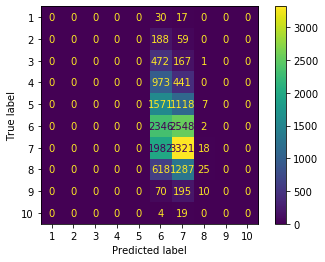

In [23]:
run_classifier(LogisticRegression, 5)
clf_lr = LogisticRegression(multi_class='multinomial').fit(X_train_class, y_train_class)
metrics.plot_confusion_matrix(clf_lr, X_test_class, y_test_class)
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas

Average ACC:
	Training: 0.376851216392472 Testing:0.3651113446819611
Average ERR:
	Training: 0.623148783607528 Testing: 0.6348886553180388
Average PREC:
	Training: 0.4129442513987579 Testing: 0.4035600525552079
Average REC:
	Training: 0.44677737112294136 Testing: 0.4370054953165277
Average F1:
	Training: 0.42916138268014575 Testing: 0.41958869410738664
Average MSE:
	Training: 3.655105718818357 Testing: 0.0


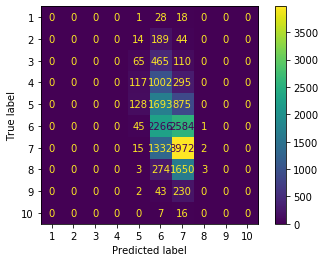

In [25]:
run_classifier(RandomForestClassifier, 5)
clf_rf = RandomForestClassifier(n_estimators=175, max_depth=9).fit(X_train_class, y_train_class)
metrics.plot_confusion_matrix(clf_rf, X_test_class, y_test_class)
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\lib\site-packages\pandas

Average ACC:
	Training: 0.3681562116100089 Testing:0.36559749300696676
Average ERR:
	Training: 0.6318437883899912 Testing: 0.6344025069930332
Average PREC:
	Training: 0.42494536314144593 Testing: 0.42242784171803277
Average REC:
	Training: 0.3055939263225459 Testing: 0.3036459535206768
Average F1:
	Training: 0.3553569702528545 Testing: 0.3531375210360634
Average MSE:
	Training: 3.6693035133008918 Testing: 0.0


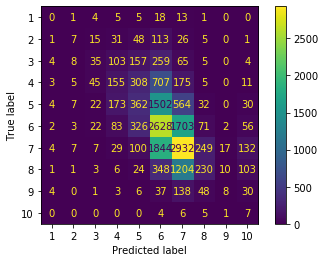

In [28]:
run_classifier(AdaBoostClassifier, 5)
clf_ab = AdaBoostClassifier(n_estimators=175).fit(X_train_class, y_train_class)
metrics.plot_confusion_matrix(clf_ab, X_test_class, y_test_class)
plt.show()

## Classifier Results:
As expected the classifiers performed pretty poorly overall. With Logistic Regression models performing very poorly on Testing and Training, it again seems that this is a problem that shouldn't be represented linearly. Also, Random Forest models were very overfit compared to the other two models, likely due to the fact that it created its Trees on smaller splits, leading to many small, overfit decision trees. Overall, Adaboost performed the best, but still poorly, which makes sense given that each decision tree will likely perform poorly for this problem and Adaboost does well with many weak classifiers. All in all, classification seems to be a worse representation of this problem.

## Neural Network: 
We will be using scikits Multi-Layer Perceptron regressor and will also subsequently utilize the grid_search CV package to hyperparameter tune on the different configurations 

In [ ]:
number_of_features = len(df.keys())
number_of_features

In [ ]:
param_grid = [
    {'activation':['identity','logistic','tanh','relu'], 
     'hidden_layer_sizes':[(number_of_features), (int(number_of_features/2)), (int(number_of_features/4)), (int(number_of_features/8)), (int(number_of_features/16))]
    }

 ]
total_x = df.copy()
total_y = list(df['averageRating'])

total_x.drop(columns=['averageRating','numVotes'], inplace=True) 

nn_search_cv = GridSearchCV(MLPRegressor(max_iter=2000), param_grid[0], n_jobs=-1, scoring='r2')
nn_search_cv.fit(total_x, total_y)

print(nn_search_cv.cv_results_['params'][nn_search_cv.best_index_])


In [7]:
run_model(MLPRegressor(activation='logistic', hidden_layer_sizes=(42), max_iter=2000))

Average MSE:
	Training: 0.604249581831656 Testing:0.6389311317477591
Average R2:
	Training:0.3957503067103264 Testing: 0.3610633659320127
